In [1]:
from IPython.core.display import display, HTML

display(HTML("<style>.container { width:100% !important; }</style>"))

### Данные для построения приложены к домашнему заданию (data.csv)

Привет! В этом задании тебе предстоит построить модель для задачи предсказания дефолта клиента. Тебе предоставлен набор признаков и целевая переменная — факт выхода клиентов в просрочку глубины 4 на горизонте 12 месяцев. Нужно провести анализ признаков и выявить наиболее релевантные к задаче, проанализировать их и простроить линейную модель. Этот проект не имеет жестких ограничений на многие пункты и допускает во многом **вольный подход** к его выполнению: например, мы предлагаем самостоятельно выбрать подход к заполнению пропущенных значений и не накладываем никаких ограничений. Таких пунктов в этом проекте много, цель проста: проанализировать то, как ты **самостоятельно** принимаешь решения. Единственное, советуем **аргументировать** свои решения и стараться **интепретировать** полученные результаты, аргументация будет также учтена при оценивании работы. 

### Как будет оцениваться ваша работа: 
Все пункты (1-12) весят одинаково, итоговая оценка — количество правильно выполненных пунктов. В случае отсутствия аргументации/выводов за пункт ставится 0.5 

### Задание
0. Разбейте выборку на train, val, test (обучение и анализ модели проводите на train). Разбиение аналогично тому, что проводилось на семинаре (60/20/20, без шаффла). В случае иного разбиения модель качество модели будет считаться **невалидным**. 
1. Исследуйте и  заполните пропуски, **обоснуйте** метод и выскажете свои предположения о возможных причинах их появления
2. Отберите все признаки по ROC-AUC > 0.525
3. Проведите EDA для трёх самых сильных признаков. Как думаете, как **интерпретировать** эти зависимости? (https://en.wikipedia.org/wiki/Exploratory_data_analysis)
4. Постройте матрицу корреляций, удалите все сильные корреляты, поясните свой выбор
5. Настройте градиентный бустинг так, чтобы на тесте качество было не меньше **0.646** (тест никак не должен участвовать в настройке модели) (https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.LGBMClassifier.html)
6. Визуализируйте 7 самых сильных признаков по gain (https://lightgbm.readthedocs.io/en/latest/pythonapi/lightgbm.plot_importance.html) Как думаете, **как работает** самый сильный признак? Почему?(больше -> лучше, меньше -> лучше)
7. Реализуйте функцию **stepwise** для логистической регрессии
8. Отберите признаки с порогами 10 и 15% 
9. Обучите логистическую регрессию на признаках, **отобранных** по stepwise
9. Визуализируйте силу признаков линейной модели
10. Сильно ли различается результат по сравнению с бустингом? Как думаете, **почему**?
11. Посчитайте **на тесте** ROC-AUC вашей модели, как считаете, не переобучилась ли она?

### Описание признаков

1. max_util (максимальная утилизация по КК)
2. avg_util (средняя утилизация по КК)
3. credits_2y (количество кредитов за последние 2 года)
4. credits_4y (количество кредитов за последние 4 года)
5. bad_history_credits_flg (наличие кредитов в подозрительных кредитных организациях)
6. other_util (отношение задолженности к сумме кредитов в других организациях)
7. avg_term (средний срок кредита)
8. min_term (минимальный срок кредита)
9. avg_limit_mortgage (средний лимит по ипотекам)
10. min_limit_mfo (минимальный лимит в мфо)
11. close_balance_amt (выплаченная сумма)
12. soc_dem_score (скоринговый балл основанный на соц-дем показателях)
13. max_delq_cnt (максимальное число просрочек по кредиту)
14. avg_active_time (среднее оставшееся время по открытам кредитам)
15. last_credit_time_years (время (в годах) с последнего закрытого кредита)

### Чек лист готовности работы ('x' чтобы поставить галочку)

- [x]  Признаки отобраны по ROC-AUC
- [x]  EDA проведён
- [x]  Корреляты удалены
- [x]  Градиентный бустинг обучен и достигает нужного качества
- [x]  Самые сильные признаки отобраны
- [x]  Stepwise реализован 
- [x]  Линейная модель обучена, проанализирована сила признаков 
- [x]  Метрики на тесте посчитаны
- [x]  Проведено сравнение качества моделей, выдвинуты гипотезы о причинах наблюдаемых результатов

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from scipy import stats
import plotly.express as px

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from scipy.stats import bernoulli, norm
from plotly.subplots import make_subplots

from sklearn.metrics import r2_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from sklearn.metrics import roc_curve
from sklearn import preprocessing
from sklearn.metrics import precision_score, recall_score, auc, accuracy_score, roc_auc_score,f1_score,log_loss,\
classification_report, roc_curve


from sklearn import model_selection, datasets, metrics, tree, ensemble
import lightgbm as lgb
from lightgbm import LGBMClassifier, plot_importance
import time
from sklearn.preprocessing import StandardScaler
from scipy.stats.distributions import chi2
from statsmodels.stats.outliers_influence import variance_inflation_factor
from itertools import product
from sklearn.model_selection import GridSearchCV
import matplotlib.pyplot as plt

In [3]:
data = pd.read_csv('scoring-data.csv')
data = data.sort_values(by=['user_id'])

features = np.delete(data.columns.values, [0,1,2])

In [5]:
features

array(['max_util', 'avg_util', 'credits_2y', 'credits_4y',
       'bad_history_credits_flg', 'other_util', 'avg_term', 'min_term',
       'avg_limit_mortgage', 'min_limit_mfo', 'close_balance_amt',
       'soc_dem_score', 'max_delq_cnt', 'avg_active_time',
       'last_credit_time_years'], dtype=object)

In [4]:
#в данных есть дубликаты
data[data.duplicated()].head()

,user_id,d4p12,month_dt,max_util,avg_util,credits_2y,credits_4y,bad_history_credits_flg,other_util,avg_term,min_term,avg_limit_mortgage,min_limit_mfo,close_balance_amt,soc_dem_score,max_delq_cnt,avg_active_time,last_credit_time_years
214016,214016.0,0.0,2020-01-01,0.988086,0.086648,0.0,0.0,1.0,0.213042,43.888889,-9.0,-1.0,40588.0,71536.00,-6.602685,0.0,60.0,4.0
214017,214017.0,0.0,2020-01-01,1.014761,0.113640,0.0,0.0,1.0,0.243213,103.000000,-66.0,1064000.0,-1.0,1167919.00,-5.529557,0.0,33.0,2.0
222278,214018.0,0.0,2020-01-01,0.807676,0.134613,0.0,1.0,1.0,0.233445,181.000000,0.0,-1.0,-1.0,418788.00,-6.997209,0.0,-6.0,0.0
214019,214019.0,0.0,2020-01-01,0.984580,0.304411,1.0,1.0,1.0,0.302955,18.166667,1.0,-1.0,33435.0,210610.95,-4.794389,0.0,60.0,6.0
222280,214020.0,0.0,2020-01-01,1.039535,0.105284,0.0,0.0,1.0,0.205686,11.068966,-13.0,5661000.0,15000.0,558595.00,-3.521438,0.0,300.0,1.0


In [6]:
data.drop_duplicates(keep = 'first', subset = 'user_id', inplace = True)

#### 0. Разбиваем выборку на обучающую, валидационную и тестовую в соотношении 60/20/20

In [7]:
def test_val_split(df, val_size=0.2, test_size=0.2):
    
    """
        Функция для разбиения выборки на три части по времени (hold-out подход)
        
        Parameters
        ----------
        df : DataFrame
            датафрейм с наблюдениями и целевой переменной
        val_size : str
            размер валидационной выборки
        test_size : str
            размер тестовой выборки

        Returns
        ---
        df : pandas.DataFrame
           исходный датафрейм с новой колонкой sample_part принимающей три значения:
           'train', 'val', 'test'

    """
    
    X_train, X_test, y_train, y_test = train_test_split(
        df[features], df['d4p12'], test_size=val_size+test_size, shuffle=False)
    df.assign(sample_part='')
    df.loc[X_test.index, 'sample_part'] = 'test'
    X_val, X_test, y_val, y_test = train_test_split(
        df[features][df['sample_part'] == 'test'], df['d4p12'][df['sample_part'] == 'test'],\
        test_size=test_size / (test_size + val_size), shuffle=False)
    df.loc[X_val.index, 'sample_part'] = 'val'
    df.loc[X_train.index, 'sample_part'] = 'train'
    
    return df

In [15]:
data = test_val_split(data, val_size = 0.2, test_size = 0.2)

X_train = (data[data['sample_part'] == 'train'].iloc[:, 3:]).drop(columns = 'sample_part')
y_train = data[data['sample_part'] == 'train'].iloc[:, 1]

X_val = (data[data['sample_part'] == 'val'].iloc[:, 3:]).drop(columns = 'sample_part')
y_val = data[data['sample_part'] == 'val'].iloc[:, 1]

X_test = (data[data['sample_part'] == 'test'].iloc[:, 3:]).drop(columns = 'sample_part')
y_test = data[data['sample_part'] == 'test'].iloc[:, 1]

In [10]:
def sample_part_distribution(df, date='month_dt', train_nm='train', val_nm='val', test_nm='test', title='Выборка для построения'):
        
    """
        Функция для визуализации разбиения категорий в колонке sample_part
        
        Parameters
        ----------
        df : DataFrame
            датафрейм с наблюдениями и целевой переменной
        date : str
            поле по которому будет проводится группировка по времени
        test_nm : str
            название тестовой категории в sample_part 
        val_nm : str
            название валидацинной категории в sample_part 
        train_nm : str
            название категории для обучения в sample_part 
        title : str
            название категории для обучения в sample_part 

    """
    
    fig = go.Figure()
    fig = make_subplots(specs=[[{"secondary_y": True}]])
    fig.add_trace(
        go.Bar(
            x=sorted(set(df[date][df['sample_part'] == train_nm])),
            y=df[df['sample_part'] == train_nm].groupby(date).user_id.count(), 
            marker_color='indianred', name='train'
        ))
    fig.add_trace(
        go.Bar(
            x=sorted(set(df[date][df['sample_part'] == val_nm])),
            y=df[df['sample_part']== val_nm].groupby(date).user_id.count(), 
             marker_color='lightsalmon', name='validation'
        ))
    fig.add_trace(
        go.Bar(
            x=sorted(set(df[date][df['sample_part']== test_nm])),
            y=df[df['sample_part']== 'test'].groupby(date).user_id.count(), 
            marker_color='lightslategray', name='test'
        ))
    fig.update_layout(barmode='relative', title_text=title)
    fig.show()

In [11]:
sample_part_distribution(data)

In [12]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 222275 entries, 0 to 222274
Data columns (total 19 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   user_id                  222275 non-null  float64
 1   d4p12                    222275 non-null  float64
 2   month_dt                 222275 non-null  object 
 3   max_util                 222275 non-null  float64
 4   avg_util                 222275 non-null  float64
 5   credits_2y               222275 non-null  float64
 6   credits_4y               222275 non-null  float64
 7   bad_history_credits_flg  222275 non-null  float64
 8   other_util               222275 non-null  float64
 9   avg_term                 222237 non-null  float64
 10  min_term                 222237 non-null  float64
 11  avg_limit_mortgage       222275 non-null  float64
 12  min_limit_mfo            222275 non-null  float64
 13  close_balance_amt        222275 non-null  float64
 14  soc_

#### 1. Заполняем пропуски в данных

Посмотрим на распределение таргетов

In [13]:
data[['user_id', 'd4p12']].groupby('d4p12').count()

,user_id
d4p12,
0.0,208386
1.0,13889


In [14]:
data[(data[features] < 0)].describe()[features] #смотрим на распределение данных с отрицательными значениями 

,max_util,avg_util,credits_2y,credits_4y,bad_history_credits_flg,other_util,avg_term,min_term,avg_limit_mortgage,min_limit_mfo,close_balance_amt,soc_dem_score,max_delq_cnt,avg_active_time,last_credit_time_years
count,0.0,0.0,0.0,0.0,0.0,0.0,14391.000000,124012.000000,178245.0,192708.0,0.0,222230.000000,0.0,28746.000000,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,-9.780545,-39.976317,-1.0,-1.0,NaN,-6.110588,NaN,-31.958673,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,12.188387,37.105606,0.0,0.0,NaN,1.748801,NaN,33.907201,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,-360.214286,-1452.000000,-1.0,-1.0,NaN,-14.101289,NaN,-181.000000,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,-12.620192,-61.000000,-1.0,-1.0,NaN,-7.285721,NaN,-47.000000,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,-6.333333,-33.000000,-1.0,-1.0,NaN,-6.099632,NaN,-19.000000,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,-2.666667,-14.000000,-1.0,-1.0,NaN,-4.923411,NaN,-6.000000,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,-0.013333,-1.000000,-1.0,-1.0,NaN,-0.020462,NaN,-1.000000,NaN


Интерпретируем отрицательные значения признаков:

avg_term, min_term, avg_active_time - выбросы/противоречия, причем у max_util, credits_2y одиночные выбросы

avg_limit_mortgage, min_limit_mfo - скорее всего -1 означает то, что у данного клиента нет данных по данному признаку; например, он не брал кредитов в МФО и не брал ипотеку

soc_dem_score - шкала

In [9]:
print(X_train.isna().sum(),'\n') #avg_term, min_term, avg_active_time
print(X_test.isna().sum(),'\n') #avg_term, min_term, avg_active_time 
print(X_val.isna().sum()) #avg_term, min_term, avg_active_time 

max_util                      0
avg_util                      0
credits_2y                    0
credits_4y                    0
bad_history_credits_flg       0
other_util                    0
avg_term                     32
min_term                     32
avg_limit_mortgage            0
min_limit_mfo                 0
close_balance_amt             0
soc_dem_score                 0
max_delq_cnt                  0
avg_active_time            7938
last_credit_time_years        0
dtype: int64 

max_util                      0
avg_util                      0
credits_2y                    0
credits_4y                    0
bad_history_credits_flg       0
other_util                    0
avg_term                      1
min_term                      1
avg_limit_mortgage            0
min_limit_mfo                 0
close_balance_amt             0
soc_dem_score                 0
max_delq_cnt                  0
avg_active_time            2886
last_credit_time_years        0
dtype: int64 

max_util  

Проверим, есть ли выбросы

In [16]:
X_train.describe()

,max_util,avg_util,credits_2y,credits_4y,bad_history_credits_flg,other_util,avg_term,min_term,avg_limit_mortgage,min_limit_mfo,close_balance_amt,soc_dem_score,max_delq_cnt,avg_active_time,last_credit_time_years
count,133365.000000,133365.000000,133365.000000,133365.000000,133365.000000,133365.000000,133333.000000,133333.000000,1.333650e+05,1.333650e+05,1.333650e+05,133365.000000,133365.000000,125427.000000,133365.000000
mean,1.368866,0.312054,0.369722,0.542766,0.869771,0.341020,95.811467,-13.846797,3.896378e+05,8.089380e+03,7.476103e+05,-6.000103,0.056896,133.066573,1.341101
std,10.462219,1.201940,0.639296,0.786837,0.336557,0.195921,137.411380,82.810861,1.181988e+06,5.115027e+04,3.061915e+06,1.747457,0.644299,416.740685,2.861528
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.161775,-358.500000,-1452.000000,-1.000000e+00,-1.000000e+00,0.000000e+00,-13.725520,0.000000,-181.000000,0.000000
25%,0.705566,0.099436,0.000000,0.000000,1.000000,0.220347,14.000000,-40.000000,-1.000000e+00,-1.000000e+00,7.273800e+04,-7.172610,0.000000,9.000000,0.000000
50%,0.948536,0.203942,0.000000,0.000000,1.000000,0.263020,46.357143,-7.000000,-1.000000e+00,-1.000000e+00,2.676630e+05,-5.987940,0.000000,43.000000,1.000000
75%,1.000000,0.363455,1.000000,1.000000,1.000000,0.368915,132.857143,1.000000,-1.000000e+00,-1.000000e+00,7.368240e+05,-4.817570,0.000000,111.000000,2.000000
max,1821.747200,205.623958,13.000000,14.000000,1.000000,1.000000,9852.000000,1130.000000,8.461661e+07,3.635428e+06,7.277486e+08,1.379810,38.000000,29524.000000,201.000000


Заметим, что есть противоречащие логике данных выбросы значений переменных max_util, avg_util, avg_term, min_term, avg_active_time и в last_credit_time_years. Удалим верхние 2% этих признаков в датасете

In [10]:
out_features = ['max_util', 'avg_util', 'avg_term', 'min_term', 'last_credit_time_years'] #avg_active_time не рассматриваем, 
                                                                                          #так как много данных удалится

In [11]:
q98 = X_train[out_features].quantile(0.98)


Первичная обработка данных

In [16]:
def clearing_0(df, y):
    df['target'] = y
    #выкидываем верхние 2%(считаем перцентили от трейн выборки)
    for feature in out_features:
        df = df[df[feature] <= q98[feature]]
    
    df[df[['avg_limit_mortgage', 'min_limit_mfo']] < 0] = 0 #зануляем те -1, которые показывают, что у клиента нет данных
    df[df[['avg_term', 'min_term', 'avg_active_time']] < 0] = np.nan #заполняем NaN-ами отрицательные значения данных признаков
    
    y = df['target']
    df.drop(columns = 'target', inplace = True)
    return df, y
    
X_train, y_train = clearing_0(X_train, y_train)
X_val, y_val = clearing_0(X_val, y_val)
X_test, y_test = clearing_0(X_test, y_test)

Посмотрим, чем можно заменить отрицательные/пустые значения в avg_term, min_term и avg_active_time

In [22]:
def woe_line(x, y, n_bins, feature_name, target_name):
    """ 
    Строит график зависимости WoE
    x - параметр, от которого стоит искать зависимость
    y - метки класса (0 / 1)
    n_buckets - количество бинов для вещественного признака
    feature_name, target_name - подписи к графику
    
    """
    df  = pd.DataFrame({'feature': list(x), 'target': list(y)})
    df = df[df['feature'].notna()]
    
    #для вещественных фичей
    if (type(list(df['feature'])[0]) == float):
        df = df.assign(bucket = np.ceil(df['feature'].rank(pct=True) * n_bins))
        bucket_set = sorted(set(df['bucket']))
        values, woes, iv = [], [], 0
        for bucket in bucket_set:
        
            #вычисляем woe для каждого бакета
            y1_cnt = sum(df['target']) #количество 1
            y0_cnt = len(df['target']) - sum(df['target']) #количество 0
            woe_bucket = np.log(len(df[(df['bucket'] == bucket) & (df['target'] == 1)])) - np.log(len(df[(df['bucket'] == bucket) & (df['target'] == 0)])) - np.log(y1_cnt / y0_cnt)
            iv += woe_bucket * (len(df[(df['bucket'] == bucket) & (df['target'] == 1)])/len(df['target'] == 1) - len(df[(df['bucket'] == bucket) & (df['target'] == 0)])/len(df['target'] == 0))            
            values.append(df[df['bucket'] == bucket]['feature'].mean()) #средние значения фичи
            woes.append(woe_bucket) #woe
            
        #обучаем линейную регрессию регрессию между фичей и таргетом, рисуем линию
        lr = LinearRegression()
        lr.fit(np.array(values).reshape(-1,1), woes)
        woe_pred = lr.predict(np.array(values).reshape(-1,1))

        #строим woe_line
        fig = go.Figure()
        fig.add_trace(go.Scatter(
                x = values,
                y =  woes,
                name = 'WoE',
                line = dict(color='firebrick', width=1, dash='dot'),
           ))
        
        #строим линейную регрессию
        fig.add_trace(go.Scatter(
            x = values,
            y = woe_pred,
            line = dict(color='royalblue', width=2),
            mode = 'lines',
            name = f'Linear Regression\n'
        ))
        fig.update_layout(title_text= \
                          f'Weight of Evidence Line: {feature_name} | {target_name} | X_0: {-round(float(lr.intercept_ / lr.coef_),3)} | R^2: {round(r2_score(woes, woe_pred),3)} | IV: {round(iv, 3)} | ROC AUC: {round(roc_auc_score(df.target, df.feature),3)}') 
        
        #строим гистограмму распределения - убрал, потому что много места занимает
        dist = px.histogram(df, x=df[df.columns[0]], color=df[df.columns[2]])
        fig.show()
        dist.show()
        
    #для категориальных фичей
    if (type(list(df['feature'])[0]) == str):
        woes = []
        cats = []
        iv = 0
        set_cats = df.groupby('feature').count()['target']
        set_cats = set_cats.sort_values(ascending = False).keys()
        for cat in set_cats:
            
            #вычисляем woe для каждой категории
            y1_cnt = sum(df['target']) #количество 1
            y0_cnt = len(df['target']) - sum(df['target']) #количество 0
            woe_cat = np.log(len(df[(df['feature'] == cat) & (df['target'] == 1)])) - np.log(len(df[(df['feature'] == cat) & (df['target'] == 0)])) - np.log(y1_cnt / y0_cnt)
            iv += woe_cat * (len(df[(df['feature'] == cat) & (df['target'] == 1)])/len(df['target'] == 1) - len(df[(df['feature'] == cat) & (df['target'] == 0)])/len(df['target'] == 0))
            woes.append(woe_cat)
            cats.append(cat)
        
        #строим woe
        fig = go.Figure()
        fig.add_trace(go.Scatter(
                x = cats,
                y =  woes,
                name = 'WoE',
                line = dict(color='firebrick', width=1, dash='dot'),
           ))
        fig.update_layout(title_text=f'Weight of Evidence Line: {feature_name} | {target_name} | IV: {round(iv, 3)}')
        
        #строим гистограмму распределения если хотим - убрал, потому что много места занимает
        dist = px.histogram(df, x=df[df.columns[0]])
        dist.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})
        fig.show()
        dist.show()

In [23]:
nan_features = ['avg_active_time', 'avg_term', 'min_term']

In [22]:
for feature in nan_features:
    woe_line(X_train[feature], 
         y_train, 
         n_bins = 15,
         feature_name = feature, 
         target_name = '4-depth default')

* Способ 1. Заполним пропуски значениями $x_0$ такими, что WoE($x_0$) = 0
* Способ 2. Заполним пропуски медианными значениями (средним будет хуже, так как большие выбросы)
* Способ 3. Заполним пропуски нулями\
Лучший способ отберем по ROC AUC

In [23]:
out_features

['max_util', 'avg_util', 'avg_term', 'min_term', 'last_credit_time_years']

In [24]:
x_0 = [277.11, 97.98, -1.13] #нули WOE_line

In [25]:
for i, feature in enumerate(nan_features):
    print('~~~',feature,'~~~')
    print(f'WoE:{roc_auc_score(y_train, X_train[feature].fillna(x_0[i]))} | median: {roc_auc_score(y_train, X_train[feature].fillna(X_train[feature].median()))} | zeroes: {roc_auc_score(y_train, X_train[feature].fillna(0))}')

~~~ avg_active_time ~~~
WoE:0.5128702689498681 | median: 0.52979108461461 | zeroes: 0.5340648767726476
~~~ avg_term ~~~
WoE:0.5238695454172408 | median: 0.5242080729085554 | zeroes: 0.526154083774461
~~~ min_term ~~~
WoE:0.49679654193716477 | median: 0.49506778501413395 | zeroes: 0.49658248253411236


Получилось, что лучше всего заполнять пропуски нулями в переменных avg_active_time и медианой в min_term (так как ROC AUC < 0.5 получился => выбираем наименьший)

In [17]:
min_term_median = X_train['min_term'].median()

In [18]:
def filling(df):
    df[['avg_active_time', 'avg_term']] = df[['avg_active_time', 'avg_term']].fillna(0)
    df['min_term'] = df['min_term'].fillna(min_term_median)
    return df

In [19]:
#заполнение пропусков
X_train = filling(X_train)
X_val = filling(X_val)
X_test = filling(X_test)

In [31]:
X_train.head()

,max_util,avg_util,credits_2y,credits_4y,bad_history_credits_flg,other_util,avg_term,min_term,avg_limit_mortgage,min_limit_mfo,close_balance_amt,soc_dem_score,max_delq_cnt,avg_active_time,last_credit_time_years
1,0.928482,0.271159,0.0,0.0,1.0,0.296724,86.928571,1.0,0.0,0.0,1424742.89,-7.067999,0.0,49.0,1.0
3,1.042425,0.230797,1.0,1.0,1.0,0.284345,116.615385,1.0,0.0,0.0,138969.00,-5.073265,0.0,23.0,3.0
4,0.960127,0.326562,2.0,2.0,1.0,0.334188,188.200000,1.0,0.0,0.0,53620.00,-7.226236,0.0,14.0,2.0
5,0.788011,0.157440,0.0,0.0,1.0,0.237930,7.916667,1.0,2000000.0,0.0,774897.50,-6.956678,0.0,129.0,0.0
7,0.759770,0.228972,0.0,0.0,1.0,0.270810,10.142857,1.0,0.0,0.0,746300.00,-6.859715,0.0,39.0,0.0


#### 2. Отбор по ROC-AUC

In [20]:
def filter_by_score(X, features, y, score=roc_auc_score, threshold = 0.5, best_n = 3):
    
    """
        Функция для фильтрации признаков по заданной метрике качества
        Parameters
        ----------
        X_train : DataFrame
            датафрейм с наблюдениями и целевой переменной
        features : str
            список переменных для фильтрации
        y_train : str
            целевая переменная 
        score : func
            функция формата func(y_true, y_pred) по которой будут отбираться признаки
            по умолчанию используется sklearn.metrics.roc_auc_score
        threshold : float 
            пороговое значение метрики
        best_n: int
            количество топ-переменных по заданному score
        Returns
        ---
        object : pandas.Series
           Series с подходящими значениями score
    """
    metrics = {}
    for feature in features:
        if max(roc_auc_score(y, X[feature]), 1-roc_auc_score(y, X[feature])) > threshold:
            metrics[feature] = max(roc_auc_score(y, X[feature]), 1-roc_auc_score(y, X[feature]))
            if max(roc_auc_score(y, X[feature]), 1-roc_auc_score(y, X[feature])) == 1-roc_auc_score(y, X[feature]):
                print(f'{feature} | {metrics[feature]} | Real ROC AUC < 0.5')
            else:
                print(f'{feature} | {metrics[feature]}')
                
    print(f'Топ-3 признака по ROC AUC: {list(dict(sorted(metrics.items(), key=lambda item: item[1], reverse = True)).items())[0:best_n]}')
    top_n = list(dict(sorted(metrics.items(), key=lambda item: item[1], reverse = True)).items())[0:best_n]
    return list(metrics.keys()), list(dict(top_n).keys())

In [21]:
roc_auc_features, top_n = filter_by_score(X_train, features, y_train, score = roc_auc_score, threshold = 0.525, best_n = 3)

max_util | 0.6144234363924943
avg_util | 0.5911963704589228
credits_2y | 0.5616945346104983
credits_4y | 0.5715633807000726
other_util | 0.5896419433283383
avg_term | 0.526154083774461
avg_limit_mortgage | 0.5365107247134173 | Real ROC AUC < 0.5
min_limit_mfo | 0.5381243829280002
close_balance_amt | 0.5397731635706564 | Real ROC AUC < 0.5
soc_dem_score | 0.5925324348534295
avg_active_time | 0.5340648767726476
last_credit_time_years | 0.5890823725302906
Топ-3 признака по ROC AUC: [('max_util', 0.6144234363924943), ('soc_dem_score', 0.5925324348534295), ('avg_util', 0.5911963704589228)]


#### 3. EDA по 3 топ-признакам по ROC AUC

Посмотрим на распределение признаков max_util, soc_dem_score и avg_util

1. Рассмотрим признак max_util.
Максимальная утилизация по КК - это отношение задолженности к лимиту, из графика видно, что есть выбросы в значениях 0 и 1. Это означает, что большинство людей либо всегда гасит задолженность вовремя, либо хотя бы по одной из КК имеют задолженность >= лимит, то есть тратят весь лимит (или почти весь) и не возвращают деньги по кредитке вовремя.

In [34]:
fig = px.histogram(X_train, x='max_util')
fig.show()

In [35]:
X_train['target'] = y_train

In [36]:
fig = px.histogram(X_train[X_train.target == 1], x='max_util')
fig.show()

Можно заметить, что клиенты, которые в итоге имеют просрочку глубины 4, на самом деле намного чаще всего имеют большие задолженности по кредитной карте, тратят даже больше своего лимита

2. Рассмотрим признак soc_dem_score. Проверим по QQ-plot, имеет ли признак soc_dem_score нормальное распределение.

In [37]:
fig = px.histogram(X_train, x='soc_dem_score')
fig.show()

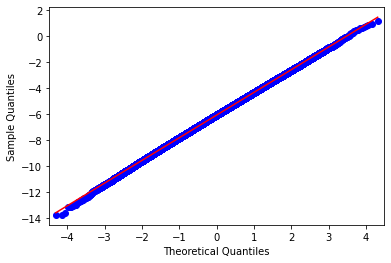

In [38]:
import pylab 
import statsmodels.api as sm

sm.qqplot(X_train['soc_dem_score'], line='q')
pylab.show()

In [39]:
print(f'mu: {np.mean(X_train.soc_dem_score)} | sigma: {np.var(X_train.soc_dem_score)}')

mu: -6.053447903720427 | sigma: 3.028364847839766


Все точки идеально садятся на линию нормального распределения, то есть признак имеет нормальное распределение. Это может быть связано с тем, что данный показатель рассчитывается "искуственно" таким образом, чтобы все оценки лежали на кривой нормального распределения со средним -6 и дисперсией 3.

Можно сделать тест Колмогорова-Смирнова для проверки того, что данное распределение является нормальным с данными параметрами. Я попробовал так сделать на этих данных, но у меня умерла оперативка:(

3. Рассмотрим признак avg_util.

In [40]:
fig = px.histogram(X_train[X_train.target == 1], x='avg_util')
fig.show()

In [41]:
fig = px.histogram(X_train[X_train.target == 0], x='avg_util')
fig.show()

Распределения по признаку avg_util отличаются у клиентов, вышедших и не вышедших в дефолт на 4ый месяц. Первое распределение (в котором клиенты выходили в дефолт) имеет более "плотный" вид по сравнению со вторым распределением (в котором клиенты не выходили в дефолт). Это может быть связано с тем, что клиенты, которые вышли в дефолт, имели чаще утилизацию по КК равной 1 и поэтому их распределение более равномерное по оси х (равномерно - не имеется в виду равномерное распределение), так как усредняя утилизацию мы получали бы что-то больше 0.
У клиентов, которые в дефолт не выходили, - сама утилизация могла быть чаще равна быть 0, поэтому в среднем она либо нулевая, либо почти нулевая (от 0.1 до 0.3)

#### 4. Корреляции

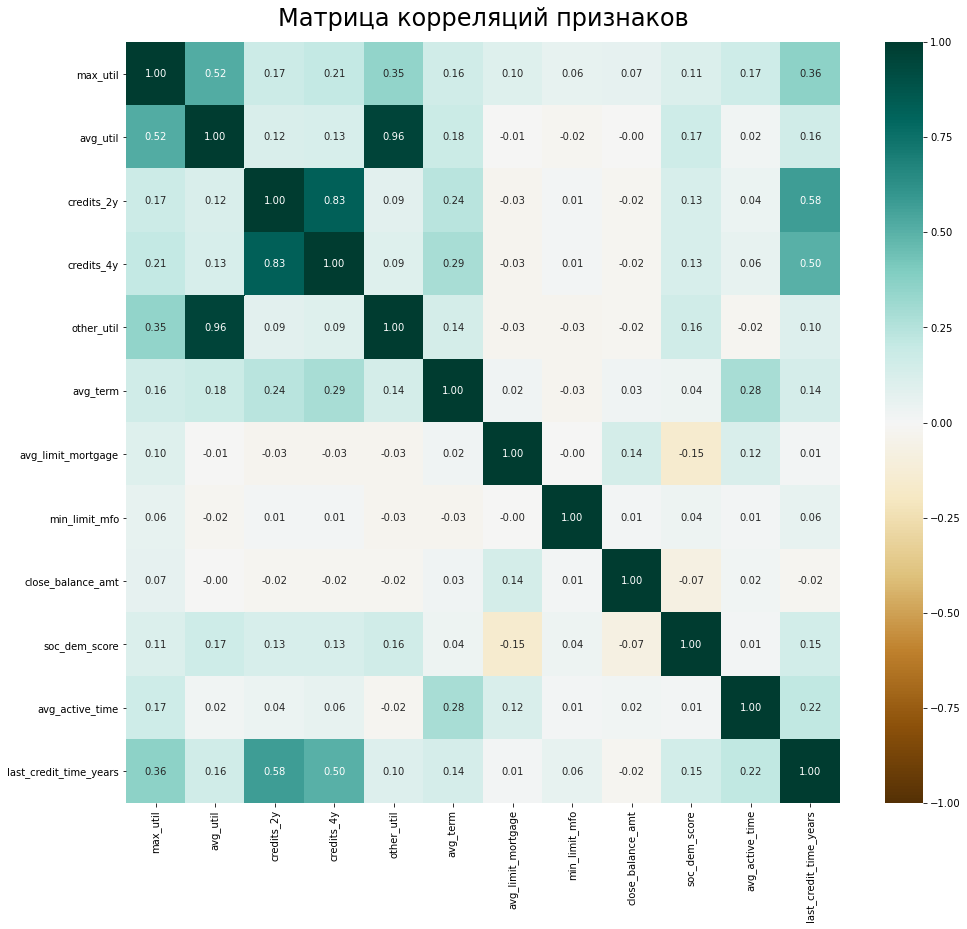

In [43]:
plt.figure(figsize=(16, 14))


heatmap = sns.heatmap(X_train[roc_auc_features].corr(), mask=None, vmin=-1, vmax=1, annot=True, cmap='BrBG', fmt=".2f")
heatmap.set_title('Матрица корреляций признаков', fontdict={'fontsize':24}, pad=16);

Еще вычислим показатель VIF для каждого признака

In [17]:
pd.DataFrame(data = {'feature':[i for i in roc_auc_features],
                     'VIF':[round(variance_inflation_factor(X_train[roc_auc_features].values,i),2) for i in range(len(roc_auc_features))]}).set_index('feature')

,VIF
feature,
max_util,9.00
avg_util,28.44
credits_2y,4.81
credits_4y,4.80
other_util,41.06
avg_term,2.12
avg_limit_mortgage,1.18
min_limit_mfo,1.03
close_balance_amt,1.09


Самые большие VIF имеют признаки other_util, avg_util, причем они сильно коррелируют с другими признаками (судя по матрице корреляций), поэтому удалим их. Также credits_2y имеет большую корреляцию с признаками credits_4y и last_credit_time_years, в то время они не сильно коррелируют с другими признаками. Поэтому удалим credits_2y.

In [22]:
cor_and_auc_features = [elem for elem in roc_auc_features if (elem != 'avg_util') and (elem != 'other_util') and (elem != 'credits_2y')]

In [19]:
cor_and_auc_features

['max_util',
 'credits_4y',
 'avg_term',
 'avg_limit_mortgage',
 'min_limit_mfo',
 'close_balance_amt',
 'soc_dem_score',
 'avg_active_time',
 'last_credit_time_years']

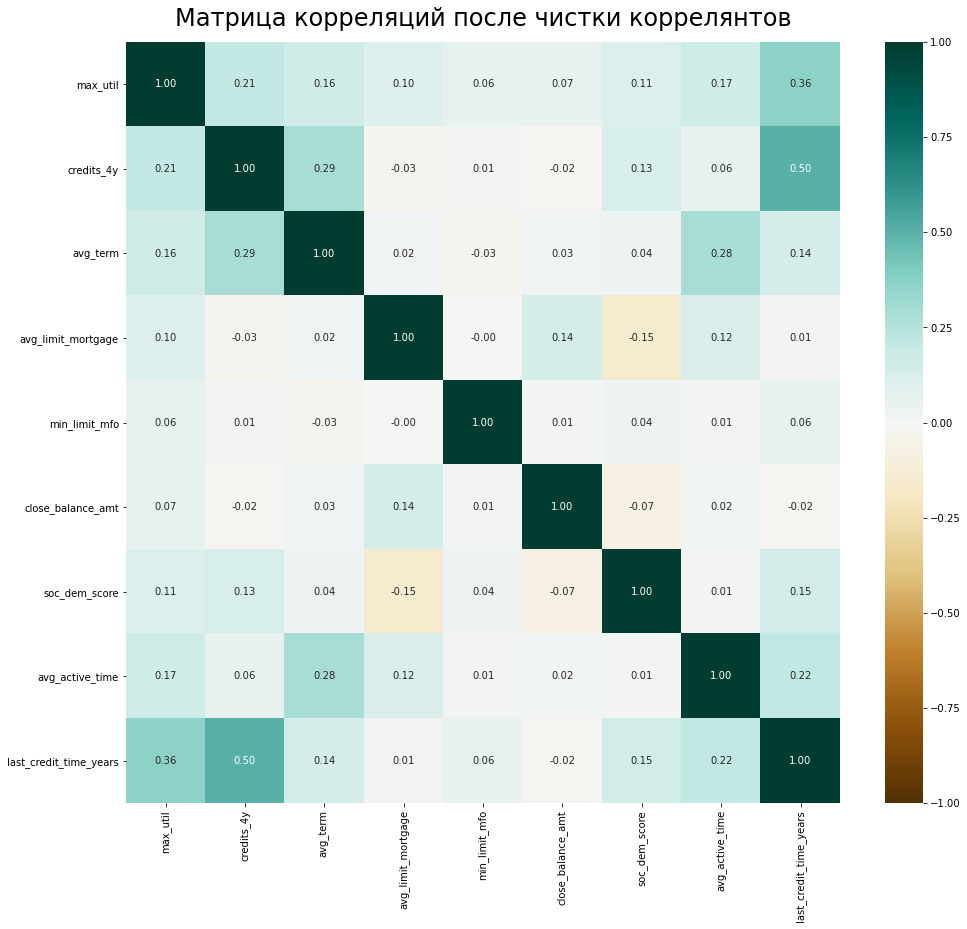

In [48]:
plt.figure(figsize=(16, 14))


heatmap = sns.heatmap(X_train[cor_and_auc_features].corr(), mask=None, vmin=-1, vmax=1, annot=True, cmap='BrBG', fmt=".2f")
heatmap.set_title('Матрица корреляций после чистки коррелянтов', fontdict={'fontsize':24}, pad=16);

#### 5. Градиентный бустинг

Настраиваем гиперпараметры градиентного бустинга таким образом, чтобы выбить на валидационной выборке более 0.646 и при этом не переобучить модель

In [31]:
def grid_search(X_train,
                X_val,
                y_train,
                y_val,
                params_dict):
    
    '''
    Функция подбирает гиперпараметры мультиномиальной логистической регрессии для получения максимального значения accuracy
    на валидационной выборке, принимает:
    X_train -- DataFrame независимых переменных на обучающей выборке
    X_val -- DataFrame независимых переменных на валидационной выборке
    y_train -- Series таргета на обучающей выборке
    y_val -- Series таргета на валидационной выборке
    params_dict -- словарь гиперпараметров в формате {'paramater_nm':[value_1, value_2, ...]}
    '''
    
    grid = []
    
    for params in product(*params_dict.values()):
        grid.append(dict(zip(params_dict.keys(), params)))
    
    best_score = 0
    best_params = {}
    
    for settings in grid:
        LGBM_clf = lgb.LGBMClassifier(**settings)
        LGBM_clf.fit(X_train,y_train)
        y_score = LGBM_clf.predict_proba(X_val)[:, 1]
        score = roc_auc_score(y_val, y_score)
        print(f'~~~ROC AUC: {round(score,4)} | Значения параметров: {settings} ~~~\n')
        if score > best_score:
            best_score = score
            best_params = settings
        if score > 0.67:
            break
            
            
    return best_score, best_params

In [32]:
params_dict = {'max_depth': np.linspace(1,4,4).astype(int),
                   'n_estimators': np.linspace(10, 100, 31).astype(int),
                   'min_samples_leaf': np.linspace(500, 4000, 20).astype(int)
}

In [71]:
grid_search(X_train[cor_and_auc_features],
                X_val[cor_and_auc_features],
                y_train,
                y_val,
                params_dict)

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6057 | Значения параметров: {'max_depth': 1, 'n_estimators': 10, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6057 | Значения параметров: {'max_depth': 1, 'n_estimators': 10, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6057 | Значения параметров: {'max_depth': 1, 'n_estimators': 10, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6057 | Значения параметров: {'max_depth': 1, 'n_estimators': 10, 'min_sam

~~~ROC AUC: 0.619 | Значения параметров: {'max_depth': 1, 'n_estimators': 13, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.619 | Значения параметров: {'max_depth': 1, 'n_estimators': 13, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.619 | Значения параметров: {'max_depth': 1, 'n_estimators': 13, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.619 | Значения параметров: {'max_depth': 1, 'n_estimators': 13, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6229 | Значения параметров: {'max_depth': 1, 'n_estimators': 19, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6229 | Значения параметров: {'max_depth': 1, 'n_estimators': 19, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6229 | Значения параметров: {'max_depth': 1, 'n_estimators': 19, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6229 | Значения параметров: {'max_depth': 1, 'n_estimators': 19, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.627 | Значения параметров: {'max_depth': 1, 'n_estimators': 22, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.627 | Значения параметров: {'max_depth': 1, 'n_estimators': 22, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6304 | Значения параметров: {'max_depth': 1, 'n_estimators': 25, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6304 | Значения параметров: {'max_depth': 1, 'n_estimators': 25, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value:

~~~ROC AUC: 0.6321 | Значения параметров: {'max_depth': 1, 'n_estimators': 28, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6321 | Значения параметров: {'max_depth': 1, 'n_estimators': 28, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6321 | Значения параметров: {'max_depth': 1, 'n_estimators': 28, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6321 | Значения параметров: {'max_depth': 1, 'n_estimators': 28, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6354 | Значения параметров: {'max_depth': 1, 'n_estimators': 34, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6354 | Значения параметров: {'max_depth': 1, 'n_estimators': 34, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6354 | Значения параметров: {'max_depth': 1, 'n_estimators': 34, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6354 | Значения параметров: {'max_depth': 1, 'n_estimators': 34, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6372 | Значения параметров: {'max_depth': 1, 'n_estimators': 37, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6372 | Значения параметров: {'max_depth': 1, 'n_estimators': 37, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6372 | Значения параметров: {'max_depth': 1, 'n_estimators': 37, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6372 | Значения параметров: {'max_depth': 1, 'n_estimators': 37, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6396 | Значения параметров: {'max_depth': 1, 'n_estimators': 43, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6396 | Значения параметров: {'max_depth': 1, 'n_estimators': 43, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6396 | Значения параметров: {'max_depth': 1, 'n_estimators': 43, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6396 | Значения параметров: {'max_depth': 1, 'n_estimators': 43, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6417 | Значения параметров: {'max_depth': 1, 'n_estimators': 49, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6417 | Значения параметров: {'max_depth': 1, 'n_estimators': 49, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6417 | Значения параметров: {'max_depth': 1, 'n_estimators': 49, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6417 | Значения параметров: {'max_depth': 1, 'n_estimators': 49, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6426 | Значения параметров: {'max_depth': 1, 'n_estimators': 52, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6426 | Значения параметров: {'max_depth': 1, 'n_estimators': 52, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6426 | Значения параметров: {'max_depth': 1, 'n_estimators': 52, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6426 | Значения параметров: {'max_depth': 1, 'n_estimators': 52, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curre

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6443 | Значения параметров: {'max_depth': 1, 'n_estimators': 58, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6443 | Значения параметров: {'max_depth': 1, 'n_estimators': 58, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6443 | Значения параметров: {'max_depth': 1, 'n_estimators': 58, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6443 | Значения параметров: {'max_depth': 1, 'n_estimators': 58,

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.644 | Значения параметров: {'max_depth': 1, 'n_estimators': 61, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.645 | Значения параметров: {'max_depth': 1, 'n_estimators': 64, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.645 | Значения параметров: {'max_depth': 1, 'n_estimators': 64, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.645 | Значения параметров: {'max_depth': 1, 'n_estimators': 64, 'min_sample

~~~ROC AUC: 0.6454 | Значения параметров: {'max_depth': 1, 'n_estimators': 67, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6454 | Значения параметров: {'max_depth': 1, 'n_estimators': 67, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6454 | Значения параметров: {'max_depth': 1, 'n_estimators': 67, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6454 | Значения параметров: {'max_depth': 1, 'n_estimators': 67, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.647 | Значения параметров: {'max_depth': 1, 'n_estimators': 73, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.647 | Значения параметров: {'max_depth': 1, 'n_estimators': 73, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.647 | Значения параметров: {'max_depth': 1, 'n_estimators': 73, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.647 | Значения параметров: {'max_depth': 1, 'n_estimators': 73, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6473 | Значения параметров: {'max_depth': 1, 'n_estimators': 76, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6473 | Значения параметров: {'max_depth': 1, 'n_estimators': 76, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6473 | Значения параметров: {'max_depth': 1, 'n_estimators': 76, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6473 | Значения параметров: {'max_depth': 1, 'n_estimators': 76, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6479 | Значения параметров: {'max_depth': 1, 'n_estimators': 82, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6479 | Значения параметров: {'max_depth': 1, 'n_estimators': 82, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6479 | Значения параметров: {'max_depth': 1, 'n_estimators': 82, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6479 | Значения параметров: {'max_depth': 1, 'n_estimators': 82, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6482 | Значения параметров: {'max_depth': 1, 'n_estimators': 85, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6488 | Значения параметров: {'max_depth': 1, 'n_estimators': 88, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6488 | Значения параметров: {'max_depth': 1, 'n_estimators': 88, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6488 | Значения параметров: {'max_depth': 1, 'n_estimators': 88, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value:

~~~ROC AUC: 0.6487 | Значения параметров: {'max_depth': 1, 'n_estimators': 91, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6487 | Значения параметров: {'max_depth': 1, 'n_estimators': 91, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6487 | Значения параметров: {'max_depth': 1, 'n_estimators': 91, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6487 | Значения параметров: {'max_depth': 1, 'n_estimators': 91, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6495 | Значения параметров: {'max_depth': 1, 'n_estimators': 97, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6495 | Значения параметров: {'max_depth': 1, 'n_estimators': 97, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6495 | Значения параметров: {'max_depth': 1, 'n_estimators': 97, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6495 | Значения параметров: {'max_depth': 1, 'n_estimators': 97, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6498 | Значения параметров: {'max_depth': 1, 'n_estimators': 100, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6498 | Значения параметров: {'max_depth': 1, 'n_estimators': 100, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6497 | Значения параметров: {'max_depth': 1, 'n_estimators': 100, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6497 | Значения параметров: {'max_depth': 1, 'n_estimators': 100, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. C

~~~ROC AUC: 0.6363 | Значения параметров: {'max_depth': 2, 'n_estimators': 13, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6363 | Значения параметров: {'max_depth': 2, 'n_estimators': 13, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6363 | Значения параметров: {'max_depth': 2, 'n_estimators': 13, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6363 | Значения параметров: {'max_depth': 2, 'n_estimators': 13, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6382 | Значения параметров: {'max_depth': 2, 'n_estimators': 16, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6412 | Значения параметров: {'max_depth': 2, 'n_estimators': 19, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6412 | Значения параметров: {'max_depth': 2, 'n_estimators': 19, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6412 | Значения параметров: {'max_depth': 2, 'n_estimators': 19, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value:

~~~ROC AUC: 0.6441 | Значения параметров: {'max_depth': 2, 'n_estimators': 22, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6441 | Значения параметров: {'max_depth': 2, 'n_estimators': 22, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6441 | Значения параметров: {'max_depth': 2, 'n_estimators': 22, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6441 | Значения параметров: {'max_depth': 2, 'n_estimators': 22, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6469 | Значения параметров: {'max_depth': 2, 'n_estimators': 28, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6467 | Значения параметров: {'max_depth': 2, 'n_estimators': 28, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6467 | Значения параметров: {'max_depth': 2, 'n_estimators': 28, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6467 | Значения параметров: {'max_depth': 2, 'n_estimators': 28, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6483 | Значения параметров: {'max_depth': 2, 'n_estimators': 31, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6476 | Значения параметров: {'max_depth': 2, 'n_estimators': 31, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6476 | Значения параметров: {'max_depth': 2, 'n_estimators': 31, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6476 | Значения параметров: {'max_depth': 2, 'n_estimators': 31, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.65 | Значения параметров: {'max_depth': 2, 'n_estimators': 37, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.65 | Значения параметров: {'max_depth': 2, 'n_estimators': 37, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.65 | Значения параметров: {'max_depth': 2, 'n_estimators': 37, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.65 | Значения параметров: {'max_depth': 2, 'n_estimators': 37, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6513 | Значения параметров: {'max_depth': 2, 'n_estimators': 43, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6515 | Значения параметров: {'max_depth': 2, 'n_estimators': 43, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6515 | Значения параметров: {'max_depth': 2, 'n_estimators': 43, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6514 | Значения параметров: {'max_depth': 2, 'n_estimators': 43, 'min_sam

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6513 | Значения параметров: {'max_depth': 2, 'n_estimators': 46, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6514 | Значения параметров: {'max_depth': 2, 'n_estimators': 46, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6509 | Значения параметров: {'max_depth': 2, 'n_estimators': 46, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.651 | Значения параметров: {'max_depth': 2, 'n_estimators': 46, 

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6523 | Значения параметров: {'max_depth': 2, 'n_estimators': 52, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6522 | Значения параметров: {'max_depth': 2, 'n_estimators': 52, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6522 | Значения параметров: {'max_depth': 2, 'n_estimators': 52, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6526 | Значения параметров: {'max_depth': 2, 'n_estimators': 52,

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6519 | Значения параметров: {'max_depth': 2, 'n_estimators': 55, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6517 | Значения параметров: {'max_depth': 2, 'n_estimators': 55, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6525 | Значения параметров: {'max_depth': 2, 'n_estimators': 58, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6526 | Значения параметров: {'max_depth': 2, 'n_estimators': 58, 'min

~~~ROC AUC: 0.6526 | Значения параметров: {'max_depth': 2, 'n_estimators': 61, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6518 | Значения параметров: {'max_depth': 2, 'n_estimators': 61, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6524 | Значения параметров: {'max_depth': 2, 'n_estimators': 61, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6526 | Значения параметров: {'max_depth': 2, 'n_estimators': 61, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6528 | Значения параметров: {'max_depth': 2, 'n_estimators': 67, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6529 | Значения параметров: {'max_depth': 2, 'n_estimators': 67, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.653 | Значения параметров: {'max_depth': 2, 'n_estimators': 67, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6526 | Значения параметров: {'max_depth': 2, 'n_estimators': 67, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current

~~~ROC AUC: 0.6531 | Значения параметров: {'max_depth': 2, 'n_estimators': 70, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6528 | Значения параметров: {'max_depth': 2, 'n_estimators': 70, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6529 | Значения параметров: {'max_depth': 2, 'n_estimators': 70, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6527 | Значения параметров: {'max_depth': 2, 'n_estimators': 70, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6536 | Значения параметров: {'max_depth': 2, 'n_estimators': 76, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6534 | Значения параметров: {'max_depth': 2, 'n_estimators': 76, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6532 | Значения параметров: {'max_depth': 2, 'n_estimators': 76, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6539 | Значения параметров: {'max_depth': 2, 'n_estimators': 76, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6535 | Значения параметров: {'max_depth': 2, 'n_estimators': 79, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6535 | Значения параметров: {'max_depth': 2, 'n_estimators': 79, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6538 | Значения параметров: {'max_depth': 2, 'n_estimators': 82, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6536 | Значения параметров: {'max_depth': 2, 'n_estimators': 82, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current valu

~~~ROC AUC: 0.6541 | Значения параметров: {'max_depth': 2, 'n_estimators': 85, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.654 | Значения параметров: {'max_depth': 2, 'n_estimators': 85, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6541 | Значения параметров: {'max_depth': 2, 'n_estimators': 85, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6541 | Значения параметров: {'max_depth': 2, 'n_estimators': 85, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.654 | Значения параметров: {'max_depth': 2, 'n_estimators': 91, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6542 | Значения параметров: {'max_depth': 2, 'n_estimators': 91, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6545 | Значения параметров: {'max_depth': 2, 'n_estimators': 91, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6539 | Значения параметров: {'max_depth': 2, 'n_estimators': 91, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current

~~~ROC AUC: 0.6545 | Значения параметров: {'max_depth': 2, 'n_estimators': 94, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 2, 'n_estimators': 94, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 2, 'n_estimators': 94, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6537 | Значения параметров: {'max_depth': 2, 'n_estimators': 94, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 2, 'n_estimators': 100, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6544 | Значения параметров: {'max_depth': 2, 'n_estimators': 100, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6542 | Значения параметров: {'max_depth': 2, 'n_estimators': 100, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6547 | Значения параметров: {'max_depth': 2, 'n_estimators': 100, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. C

~~~ROC AUC: 0.6397 | Значения параметров: {'max_depth': 3, 'n_estimators': 10, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.644 | Значения параметров: {'max_depth': 3, 'n_estimators': 13, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6441 | Значения параметров: {'max_depth': 3, 'n_estimators': 13, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6444 | Значения параметров: {'max_depth': 3, 'n_estimators': 13, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: 

~~~ROC AUC: 0.6445 | Значения параметров: {'max_depth': 3, 'n_estimators': 16, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6449 | Значения параметров: {'max_depth': 3, 'n_estimators': 16, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6458 | Значения параметров: {'max_depth': 3, 'n_estimators': 16, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6459 | Значения параметров: {'max_depth': 3, 'n_estimators': 16, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6502 | Значения параметров: {'max_depth': 3, 'n_estimators': 22, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6502 | Значения параметров: {'max_depth': 3, 'n_estimators': 22, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6498 | Значения параметров: {'max_depth': 3, 'n_estimators': 22, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.65 | Значения параметров: {'max_depth': 3, 'n_estimators': 22, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current

~~~ROC AUC: 0.6508 | Значения параметров: {'max_depth': 3, 'n_estimators': 25, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6508 | Значения параметров: {'max_depth': 3, 'n_estimators': 25, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6508 | Значения параметров: {'max_depth': 3, 'n_estimators': 25, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6508 | Значения параметров: {'max_depth': 3, 'n_estimators': 25, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.652 | Значения параметров: {'max_depth': 3, 'n_estimators': 31, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6528 | Значения параметров: {'max_depth': 3, 'n_estimators': 31, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6518 | Значения параметров: {'max_depth': 3, 'n_estimators': 31, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6519 | Значения параметров: {'max_depth': 3, 'n_estimators': 31, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6538 | Значения параметров: {'max_depth': 3, 'n_estimators': 37, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 3, 'n_estimators': 37, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6544 | Значения параметров: {'max_depth': 3, 'n_estimators': 37, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 3, 'n_estimators': 37, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6532 | Значения параметров: {'max_depth': 3, 'n_estimators': 40, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6535 | Значения параметров: {'max_depth': 3, 'n_estimators': 40, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6534 | Значения параметров: {'max_depth': 3, 'n_estimators': 40, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.654 | Значения параметров: {'max_depth': 3, 'n_estimators': 40, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6551 | Значения параметров: {'max_depth': 3, 'n_estimators': 46, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6542 | Значения параметров: {'max_depth': 3, 'n_estimators': 46, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6551 | Значения параметров: {'max_depth': 3, 'n_estimators': 46, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6539 | Значения параметров: {'max_depth': 3, 'n_estimators': 46, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6542 | Значения параметров: {'max_depth': 3, 'n_estimators': 49, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6546 | Значения параметров: {'max_depth': 3, 'n_estimators': 49, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6551 | Значения параметров: {'max_depth': 3, 'n_estimators': 52, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6552 | Значения параметров: {'max_depth': 3, 'n_estimators': 52, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current valu

~~~ROC AUC: 0.6557 | Значения параметров: {'max_depth': 3, 'n_estimators': 55, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6552 | Значения параметров: {'max_depth': 3, 'n_estimators': 55, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6543 | Значения параметров: {'max_depth': 3, 'n_estimators': 55, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6548 | Значения параметров: {'max_depth': 3, 'n_estimators': 55, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6564 | Значения параметров: {'max_depth': 3, 'n_estimators': 61, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6562 | Значения параметров: {'max_depth': 3, 'n_estimators': 61, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6564 | Значения параметров: {'max_depth': 3, 'n_estimators': 61, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6562 | Значения параметров: {'max_depth': 3, 'n_estimators': 61, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6557 | Значения параметров: {'max_depth': 3, 'n_estimators': 64, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.656 | Значения параметров: {'max_depth': 3, 'n_estimators': 64, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6554 | Значения параметров: {'max_depth': 3, 'n_estimators': 64, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6565 | Значения параметров: {'max_depth': 3, 'n_estimators': 64, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6567 | Значения параметров: {'max_depth': 3, 'n_estimators': 70, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6559 | Значения параметров: {'max_depth': 3, 'n_estimators': 70, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6567 | Значения параметров: {'max_depth': 3, 'n_estimators': 70, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6554 | Значения параметров: {'max_depth': 3, 'n_estimators': 70, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6563 | Значения параметров: {'max_depth': 3, 'n_estimators': 73, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6558 | Значения параметров: {'max_depth': 3, 'n_estimators': 73, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6564 | Значения параметров: {'max_depth': 3, 'n_estimators': 76, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6566 | Значения параметров: {'max_depth': 3, 'n_estimators': 76, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current valu

~~~ROC AUC: 0.6566 | Значения параметров: {'max_depth': 3, 'n_estimators': 79, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6558 | Значения параметров: {'max_depth': 3, 'n_estimators': 79, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6563 | Значения параметров: {'max_depth': 3, 'n_estimators': 79, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6563 | Значения параметров: {'max_depth': 3, 'n_estimators': 79, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6572 | Значения параметров: {'max_depth': 3, 'n_estimators': 85, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 3, 'n_estimators': 85, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6572 | Значения параметров: {'max_depth': 3, 'n_estimators': 85, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 3, 'n_estimators': 85, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current 

~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 3, 'n_estimators': 88, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6565 | Значения параметров: {'max_depth': 3, 'n_estimators': 88, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6559 | Значения параметров: {'max_depth': 3, 'n_estimators': 88, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.6567 | Значения параметров: {'max_depth': 3, 'n_estimators': 88, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 3, 'n_estimators': 94, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6562 | Значения параметров: {'max_depth': 3, 'n_estimators': 94, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6574 | Значения параметров: {'max_depth': 3, 'n_estimators': 94, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6561 | Значения параметров: {'max_depth': 3, 'n_estimators': 94, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6568 | Значения параметров: {'max_depth': 3, 'n_estimators': 97, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6562 | Значения параметров: {'max_depth': 3, 'n_estimators': 97, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6565 | Значения параметров: {'max_depth': 3, 'n_estimators': 100, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6572 | Значения параметров: {'max_depth': 3, 'n_estimators': 100, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current va

~~~ROC AUC: 0.6471 | Значения параметров: {'max_depth': 4, 'n_estimators': 10, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6464 | Значения параметров: {'max_depth': 4, 'n_estimators': 10, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2894
~~~ROC AUC: 0.6471 | Значения параметров: {'max_depth': 4, 'n_estimators': 10, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6469 | Значения параметров: {'max_depth': 4, 'n_estimators': 10, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6524 | Значения параметров: {'max_depth': 4, 'n_estimators': 16, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1421
~~~ROC AUC: 0.6518 | Значения параметров: {'max_depth': 4, 'n_estimators': 16, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6519 | Значения параметров: {'max_depth': 4, 'n_estimators': 16, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6511 | Значения параметров: {'max_depth': 4, 'n_estimators': 16, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6525 | Значения параметров: {'max_depth': 4, 'n_estimators': 19, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3631
~~~ROC AUC: 0.653 | Значения параметров: {'max_depth': 4, 'n_estimators': 19, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6519 | Значения параметров: {'max_depth': 4, 'n_estimators': 19, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6522 | Значения параметров: {'max_depth': 4, 'n_estimators': 19, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current

~~~ROC AUC: 0.6541 | Значения параметров: {'max_depth': 4, 'n_estimators': 25, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2157
~~~ROC AUC: 0.6542 | Значения параметров: {'max_depth': 4, 'n_estimators': 25, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6545 | Значения параметров: {'max_depth': 4, 'n_estimators': 25, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6541 | Значения параметров: {'max_depth': 4, 'n_estimators': 25, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Curre

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=684
~~~ROC AUC: 0.6577 | Значения параметров: {'max_depth': 4, 'n_estimators': 31, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6571 | Значения параметров: {'max_depth': 4, 'n_estimators': 31, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6562 | Значения параметров: {'max_depth': 4, 'n_estimators': 31, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6557 | Значения параметров: {'max_depth': 4, 'n_estimators': 31, 'min_

~~~ROC AUC: 0.6548 | Значения параметров: {'max_depth': 4, 'n_estimators': 34, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6556 | Значения параметров: {'max_depth': 4, 'n_estimators': 34, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6544 | Значения параметров: {'max_depth': 4, 'n_estimators': 34, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6553 | Значения параметров: {'max_depth': 4, 'n_estimators': 34, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6563 | Значения параметров: {'max_depth': 4, 'n_estimators': 40, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6567 | Значения параметров: {'max_depth': 4, 'n_estimators': 40, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6568 | Значения параметров: {'max_depth': 4, 'n_estimators': 40, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6555 | Значения параметров: {'max_depth': 4, 'n_estimators': 40, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6565 | Значения параметров: {'max_depth': 4, 'n_estimators': 43, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6559 | Значения параметров: {'max_depth': 4, 'n_estimators': 43, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6561 | Значения параметров: {'max_depth': 4, 'n_estimators': 43, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 46, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6567 | Значения параметров: {'max_depth': 4, 'n_estimators': 49, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6573 | Значения параметров: {'max_depth': 4, 'n_estimators': 49, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6561 | Значения параметров: {'max_depth': 4, 'n_estimators': 49, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6563 | Значения параметров: {'max_depth': 4, 'n_estimators': 49, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.659 | Значения параметров: {'max_depth': 4, 'n_estimators': 55, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6585 | Значения параметров: {'max_depth': 4, 'n_estimators': 55, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.658 | Значения параметров: {'max_depth': 4, 'n_estimators': 55, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 55, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current val

~~~ROC AUC: 0.6561 | Значения параметров: {'max_depth': 4, 'n_estimators': 58, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 4, 'n_estimators': 58, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6566 | Значения параметров: {'max_depth': 4, 'n_estimators': 58, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6575 | Значения параметров: {'max_depth': 4, 'n_estimators': 58, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6573 | Значения параметров: {'max_depth': 4, 'n_estimators': 64, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6579 | Значения параметров: {'max_depth': 4, 'n_estimators': 64, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 64, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6569 | Значения параметров: {'max_depth': 4, 'n_estimators': 64, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 67, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6571 | Значения параметров: {'max_depth': 4, 'n_estimators': 67, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6572 | Значения параметров: {'max_depth': 4, 'n_estimators': 67, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.6584 | Значения параметров: {'max_depth': 4, 'n_estimators': 70, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current v

~~~ROC AUC: 0.6584 | Значения параметров: {'max_depth': 4, 'n_estimators': 73, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6585 | Значения параметров: {'max_depth': 4, 'n_estimators': 73, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.6573 | Значения параметров: {'max_depth': 4, 'n_estimators': 73, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6579 | Значения параметров: {'max_depth': 4, 'n_estimators': 73, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6597 | Значения параметров: {'max_depth': 4, 'n_estimators': 79, 'min_samples_leaf': 684} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=868, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=868
~~~ROC AUC: 0.6592 | Значения параметров: {'max_depth': 4, 'n_estimators': 79, 'min_samples_leaf': 868} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1052, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1052
~~~ROC AUC: 0.6584 | Значения параметров: {'max_depth': 4, 'n_estimators': 79, 'min_samples_leaf': 1052} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1236, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1236
~~~ROC AUC: 0.658 | Значения параметров: {'max_depth': 4, 'n_estimators': 79, 'min_samples_leaf': 1236} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1421, min_child_samples=20 will be ignored. Current va

~~~ROC AUC: 0.657 | Значения параметров: {'max_depth': 4, 'n_estimators': 82, 'min_samples_leaf': 2894} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3078, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3078
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 82, 'min_samples_leaf': 3078} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3263, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3263
~~~ROC AUC: 0.6575 | Значения параметров: {'max_depth': 4, 'n_estimators': 82, 'min_samples_leaf': 3263} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3447, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3447
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 82, 'min_samples_leaf': 3447} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3631, min_child_samples=20 will be ignored. Curren

~~~ROC AUC: 0.6581 | Значения параметров: {'max_depth': 4, 'n_estimators': 88, 'min_samples_leaf': 1421} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1605, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1605
~~~ROC AUC: 0.6578 | Значения параметров: {'max_depth': 4, 'n_estimators': 88, 'min_samples_leaf': 1605} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1789, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1789
~~~ROC AUC: 0.6585 | Значения параметров: {'max_depth': 4, 'n_estimators': 88, 'min_samples_leaf': 1789} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=1973, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=1973
~~~ROC AUC: 0.6569 | Значения параметров: {'max_depth': 4, 'n_estimators': 88, 'min_samples_leaf': 1973} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2157, min_child_samples=20 will be ignored. Curre

~~~ROC AUC: 0.6581 | Значения параметров: {'max_depth': 4, 'n_estimators': 91, 'min_samples_leaf': 3631} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=3815, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=3815
~~~ROC AUC: 0.6576 | Значения параметров: {'max_depth': 4, 'n_estimators': 91, 'min_samples_leaf': 3815} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=4000, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=4000
~~~ROC AUC: 0.6573 | Значения параметров: {'max_depth': 4, 'n_estimators': 91, 'min_samples_leaf': 4000} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=500, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=500
~~~ROC AUC: 0.658 | Значения параметров: {'max_depth': 4, 'n_estimators': 94, 'min_samples_leaf': 500} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=684, min_child_samples=20 will be ignored. Current va

~~~ROC AUC: 0.6584 | Значения параметров: {'max_depth': 4, 'n_estimators': 97, 'min_samples_leaf': 2157} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2342, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2342
~~~ROC AUC: 0.6589 | Значения параметров: {'max_depth': 4, 'n_estimators': 97, 'min_samples_leaf': 2342} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2526, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2526
~~~ROC AUC: 0.658 | Значения параметров: {'max_depth': 4, 'n_estimators': 97, 'min_samples_leaf': 2526} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2710, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=2710
~~~ROC AUC: 0.6581 | Значения параметров: {'max_depth': 4, 'n_estimators': 97, 'min_samples_leaf': 2710} ~~~

[LightGBM] [Warning] min_data_in_leaf is set with min_samples_leaf=2894, min_child_samples=20 will be ignored. Curren

(0.659925802315582,
 {'max_depth': 4, 'n_estimators': 85, 'min_samples_leaf': 684})

In [26]:
LGBM_clf = lgb.LGBMClassifier(max_depth = 4, n_estimators = 85, min_samples_leaf = 2600, learning_rate = 0.1, random_state = 42)
LGBM_clf.fit(X_train[cor_and_auc_features], y_train)

LGBMClassifier(max_depth=4, min_samples_leaf=2600, n_estimators=85,
               random_state=42)

In [27]:
y_pred_train = LGBM_clf.predict(X_train[cor_and_auc_features])
y_pred_val = LGBM_clf.predict(X_val[cor_and_auc_features])

In [28]:
y_proba_train = LGBM_clf.predict_proba(X_train[cor_and_auc_features])[:, 1]
y_proba_val = LGBM_clf.predict_proba(X_val[cor_and_auc_features])[:, 1]

In [30]:
print(f'ROC AUC на train sample: {roc_auc_score(y_train, y_proba_train)}')
print(f'ROC AUC на validation sample: {roc_auc_score(y_val, y_proba_val)}')

ROC AUC на train sample: 0.6894108472378988
ROC AUC на validation sample: 0.657968166526169


In [31]:
y_pred_test = LGBM_clf.predict(X_test[cor_and_auc_features])
y_proba_test = LGBM_clf.predict_proba(X_test[cor_and_auc_features])[:, 1]

In [32]:
print(f'ROC AUC на test sample: {roc_auc_score(y_test, y_proba_test)}')

ROC AUC на test sample: 0.6469148873526178


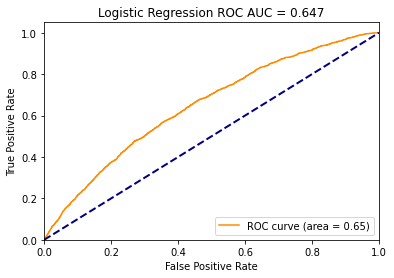

In [35]:
#рисуем график
fpr, tpr, thresholds = roc_curve(y_test, y_proba_test)

roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='darkorange', label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

plt.title('Logistic Regression ROC AUC = %0.3f' % roc_auc)
plt.legend(loc="lower right")
plt.show()

Сохраним модель

In [36]:
import pickle

In [37]:
filename = 'gbtd_model.sav'
pickle.dump(LGBM_clf, open(filename, 'wb'))

In [38]:
pickle.load(open(filename, 'rb'))

LGBMClassifier(max_depth=4, min_samples_leaf=2600, n_estimators=85,
               random_state=42)

#### 6. Feature_importance

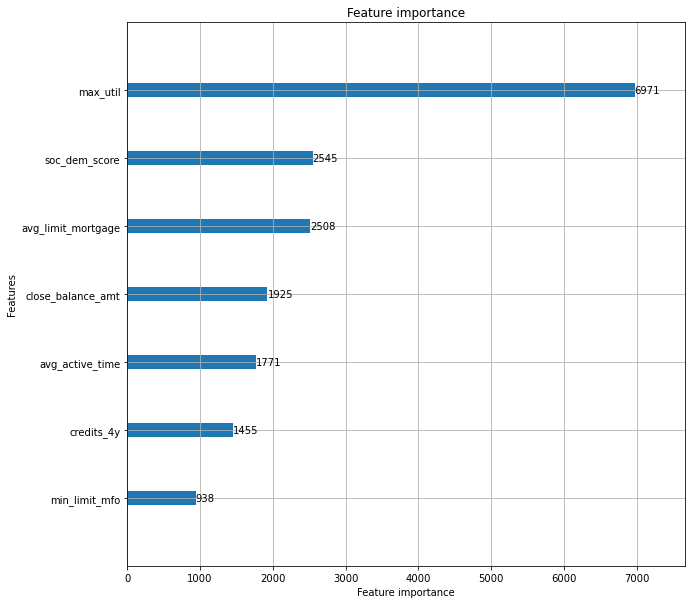

In [134]:
plot_importance(LGBM_clf, importance_type='gain', max_num_features=7, figsize=(10, 10), precision=0)
plt.show()

Получилось, что max_util (максимальная утилизация по кредитной карте) - самый сильный признак в градиентном бустинге. Объясним, как работает данный признак. 

Максимальная утилизация по КК = Задолженность / Лимит => чем ближе утилизация к 1, тем меньше ему можно доверять, чтобы одобрять ему кредит, так как у него уже есть долги по другим кредитным линиям (возможно, в других банках). В конце будет выдвинуто предположение, почему этот признак имеет такую силу в дереве решений

#### 7. Stepwise

In [44]:
def likelihood_ratio_test(ll_short, ll_long):
    
    """
    вспомогательная функция
    рассчитывает значение p-value для теста отношения правдоподобия
    ll_short — логарифм правдоподобия "короткой" модели
    ll_long — логарифм правдоподобия "длинной" модели

    Returns
    -----
    p-value
    """
    lr = 2 * (ll_short - ll_long)
    return chi2.sf(lr, 1)

In [45]:
def stepwise_selection(df, features, target = 'target', alpha_in = 0.1, alpha_out = 0.15):
    
    """
    Функция для отбора признаков при помощи прямого прохода 
    
    Parameters
    ----------
    df : DataFrame
        датафрейм с наблюдениями и целевой переменной
    features : list
        признаковое пространство
    target : str
        название целевой переменной
    alpha_in : float [0;1]
        уровень значимости, при котором переменная будет отбираться
    alpha_out : float [0;1]
        уровень значимости, при котором переменная будет исключаться

    Returns
    ---
    selected_features : list
        список переменных отобранных на заданном уровнях значимости alpha_in и alpha_out
    """
    
    selected_features = list()
    n = df.shape[0]
    p_value_in = 1
    p_value_out = 0
    while True:
        potential_features = list(set(features) - set(selected_features))
        best_feature = ''
        worst_feature = ''
        for feature in potential_features:
            temp_features = [feature] + selected_features
            lr_short = LogisticRegression(penalty='none', max_iter=500)
            lr_long = LogisticRegression(penalty='none', max_iter=500)
            
            if len(selected_features) == 0:
                const = pd.Series([1]*df.shape[0])
                lr_short.fit(np.array(const).reshape(-1, 1), df[target])
                ll_short = log_loss(df[target], lr_short.predict_proba(np.array(const).reshape(-1, 1))[:, 1], normalize=False) 
                lr_long.fit(np.array(df[temp_features]).reshape(-1, 1), df[target])
                ll_long = log_loss(df[target], lr_long.predict_proba(np.array(df[temp_features]).reshape(-1, 1))[:, 1], normalize=False)
            else:
                lr_short.fit(df[selected_features], df[target])
                ll_short = log_loss(df[target], lr_short.predict_proba(df[selected_features])[:, 1], normalize=False)
                lr_long.fit(df[temp_features], df[target])
                ll_long = log_loss(df[target], lr_long.predict_proba(df[temp_features])[:, 1], normalize=False)
            if likelihood_ratio_test(ll_short, ll_long) < alpha_in and likelihood_ratio_test(ll_short, ll_long) < p_value_in:
                p_value_in = likelihood_ratio_test(ll_short, ll_long)
                best_feature = feature  
        if best_feature == '':
            break     
        selected_features.append(best_feature)
        print(f"В модель была добавлена переменная {best_feature}, p-value: {round(p_value_in, 4)}")
        
        selected_features = list(set(selected_features))
        p_value_in = 1
        for feature in selected_features:
            temp_features = selected_features.copy()
            temp_features.remove(feature)
            
            lr_short = LogisticRegression(penalty='none', max_iter=500)
            lr_long = LogisticRegression(penalty='none', max_iter=500)
            if len(temp_features) == 0:
                const = pd.Series([1]*df.shape[0])
                lr_short.fit(np.array(const).reshape(-1, 1), df[target])
                ll_short = log_loss(df[target], lr_short.predict_proba(np.array(const).reshape(-1, 1))[:, 1], normalize=False) 
                lr_long.fit(np.array(df[selected_features]).reshape(-1, 1), df[target])
                ll_long = log_loss(df[target], lr_long.predict_proba(np.array(df[selected_features]).reshape(-1, 1))[:, 1], normalize=False)
            else:    
                lr_long.fit(df[selected_features], df[target])
                ll_long = log_loss(df[target], lr_long.predict_proba(df[selected_features])[:, 1], normalize=False)
                lr_short.fit(df[temp_features], df[target])
                ll_short = log_loss(df[target], lr_short.predict_proba(df[temp_features])[:, 1], normalize=False)
            if likelihood_ratio_test(ll_short, ll_long) > alpha_out and likelihood_ratio_test(ll_short, ll_long) > p_value_out:
                p_value_in = likelihood_ratio_test(ll_short, ll_long)
                worst_feature = feature
        p_value_out = 0
        if worst_feature == '':
            continue
        selected_features.remove(worst_feature)
        print(f"Из модели была удалена переменная {worst_feature}, p-value: {round(p_value_out, 4)}")
        
    return selected_features

In [137]:
X_train['target'] = y_train

In [41]:
train_data['target'] = train_label

#### 8. Отбор признаков с помощью stepwise selection

In [46]:
best_features = stepwise_selection(df = train_data, features = cor_and_auc_features, target = 'target', alpha_in = 0.1, alpha_out = 0.15)

В модель была добавлена переменная max_util, p-value: 0.0
В модель была добавлена переменная soc_dem_score, p-value: 0.0
В модель была добавлена переменная credits_4y, p-value: 0.0
В модель была добавлена переменная last_credit_time_years, p-value: 0.0


#### 9. Обучаем логистическую регрессию

Отмасштабируем данные

In [139]:
def scaling(df):
    return StandardScaler().fit_transform(df[best_features])

In [140]:
X_train_log_reg = scaling(X_train)
X_val_log_reg = scaling(X_val)
X_test_log_reg = scaling(X_test)

In [141]:
lr_clf = LogisticRegression()
lr_clf.fit(X_train_log_reg, y_train)

LogisticRegression()

In [142]:
y_pred_train_lr = lr_clf.predict(X_train_log_reg)
y_pred_val_lr = lr_clf.predict(X_val_log_reg)

In [143]:
y_proba_train_lr = lr_clf.predict_proba(X_train_log_reg)[:, 1]
y_proba_val_lr = lr_clf.predict_proba(X_val_log_reg)[:, 1]

In [144]:
print(f'ROC AUC на train sample: {roc_auc_score(y_train, y_proba_train_lr)}')
print(f'ROC AUC на validation sample: {roc_auc_score(y_val, y_proba_val_lr)}')

ROC AUC на train sample: 0.6379075198694918
ROC AUC на validation sample: 0.6108257624052619


In [145]:
y_pred_test_lr = lr_clf.predict(X_test_log_reg)
y_proba_test_lr = lr_clf.predict_proba(X_test_log_reg)[:, 1]

In [146]:
print(f'ROC AUC на test sample: {roc_auc_score(y_test, y_proba_test_lr)}')

ROC AUC на test sample: 0.6049382272338161


#### 10. Визуализируем силу признаков обученной логистической регрессии

In [147]:
importance_lr = pd.DataFrame({'Feature': best_features, 'Logit Coefficient': list(lr_clf.coef_[0].astype(float))})

In [148]:
fig = px.bar(importance_lr, x="Feature", y="Logit Coefficient", title="Logit Coefficients")
fig.show()

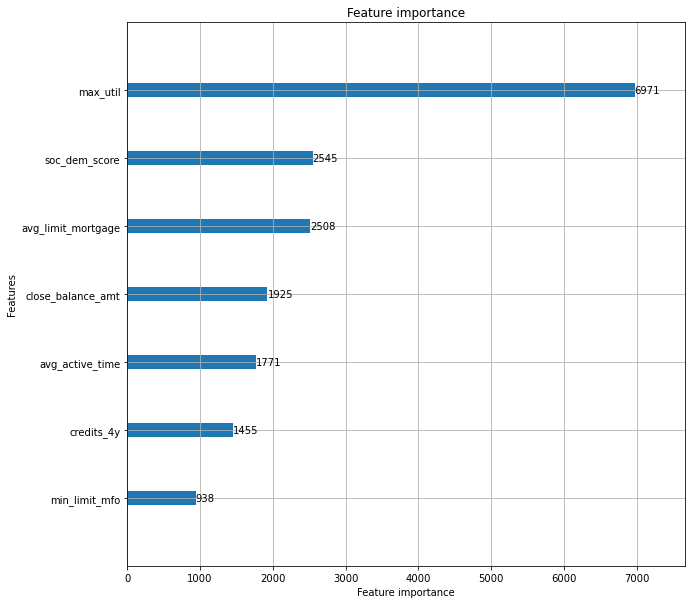

In [149]:
#выведем feature_importance и тут тоже
plot_importance(LGBM_clf, importance_type='gain', max_num_features=7, figsize=(10, 10), precision=0)
plt.show()

#### 11. Сравнение моделей бустинга деревьев и логистической регрессии.

In [150]:
from prettytable import PrettyTable

In [151]:
t = PrettyTable(['Model', 'train sample ', 'validation sample', 'test sample'])
t.add_row(['LightGBM', round(roc_auc_score(y_train, y_proba_train),4), round(roc_auc_score(y_val, y_proba_val),4), round(roc_auc_score(y_test, y_proba_test),4)])
t.add_row(['LogisticRegression', round(roc_auc_score(y_train, y_proba_train_lr),4), round(roc_auc_score(y_val, y_proba_val_lr),4), round(roc_auc_score(y_test, y_proba_test_lr),4)])
print(t)

+--------------------+---------------+-------------------+-------------+
|       Model        | train sample  | validation sample | test sample |
+--------------------+---------------+-------------------+-------------+
|      LightGBM      |     0.6894    |       0.658       |    0.6469   |
| LogisticRegression |     0.6379    |       0.6108      |    0.6049   |
+--------------------+---------------+-------------------+-------------+


Сравним сначала значимость топ-2 признаков:
(здесь также объяснение про самый сильный признак из пункта 6)
1. max_util оказался более значимым признаком в бустинге, чем в логистической регрессии. Это может объясняться логикой работы бустинга и расчета feature importance. Действительно, max_util намного лучше разделяет выборки, чем soc_dem_score, так как max_util имеет выбросы в 0 и 1, которые хорошо объясняют вероятность дефолта (то есть если клиент был с нулевой утилизацией => у него нет задолженностей => он скорее всего не выйдет в дефолт). Поэтому в деревьях решений данный признак встречается чаще в самом начале дерева. 
2. В отличие от max_util, soc_dem_score не имеет таких выбросов, которые хорошо "разделяли" бы выборки. Однако для логистической регрессии данный признак хорош: он непрерывен, хорошо интерпретирует дефолтность.

В итоге получили ROC AUC у бустинга лучше, чем у логистической регрессии. Это неудивительно, так как в нашей модели градиетного бустинга было больше используемых признаков. Также учитывая то, что градиентный бустинг более универсальная модель, чем логистическая регрессия.

Наши модели не переобучились, так как ROC AUC на тесте и на трейне отличаются не так сильно.